# The stability of the global average on different window lengths
This notebook outllines different methods that can be used to de-trend the LongRunMIP and ZECMIP time series.

# Imports

In [1]:
import numpy as np
import pandas as pd
import xarray as xr
import nc_time_axis
import json
from importlib import reload
from pprint import pprint
from scipy.stats import spearmanr
from itertools import groupby
import pymannkendall
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import matplotlib.gridspec as gridspec 
from matplotlib.axes import Axes
import matplotlib as mpl
import time
import os
import sys
import string
from enum import Enum
# from numpy.typing import ArrayLike
from typing import Optional, Callable, List, Tuple, Dict

from itertools import groupby

import warnings
warnings.filterwarnings('ignore')

In [2]:
sys.path.append(os.path.join(os.getcwd(), 'Documents/PhD'))

In [3]:
import constants
from constants import PlotConfig
sys.path.append(constants.MODULE_DIR)
import sn_plotting
import xarray_class_accessors as xca
import utils
import stats
import xarray_extender as xce
import signal_to_noise as sn
import open_ds
from classes import ExperimentTypes, LocationsLatLon
import plotting_functions
import xarray_extender as xe
import classes
logger = utils.get_notebook_logger()

In [4]:
notebook_number='01'

In [5]:
%matplotlib inline

In [6]:
from dask.distributed import Client
client = Client()
client

- State start
-   Scheduler at:     tcp://127.0.0.1:46221
-   dashboard at:        /proxy/32989/status
-         Start Nanny at: 'tcp://127.0.0.1:40109'
-         Start Nanny at: 'tcp://127.0.0.1:43471'
-         Start Nanny at: 'tcp://127.0.0.1:42749'
-         Start Nanny at: 'tcp://127.0.0.1:39319'
-         Start Nanny at: 'tcp://127.0.0.1:45453'
-         Start Nanny at: 'tcp://127.0.0.1:43427'
-         Start Nanny at: 'tcp://127.0.0.1:33965'
- Register worker <WorkerState 'tcp://127.0.0.1:43763', name: 6, status: init, memory: 0, processing: 0>
- Starting worker compute stream, tcp://127.0.0.1:43763
- Starting established connection to tcp://127.0.0.1:38648
- Register worker <WorkerState 'tcp://127.0.0.1:43689', name: 5, status: init, memory: 0, processing: 0>
- Starting worker compute stream, tcp://127.0.0.1:43689
- Starting established connection to tcp://127.0.0.1:38666
- Register worker <WorkerState 'tcp://127.0.0.1:41053', name: 1, status: init, memory: 0, processing: 0>
- 

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: /proxy/32989/status,
Dashboard: /proxy/32989/status,Workers: 7
Total threads: 14,Total memory: 63.00 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:46221,Workers: 7
Dashboard: /proxy/32989/status,Total threads: 14
Started: Just now,Total memory: 63.00 GiB
Comm: tcp://127.0.0.1:44553,Total threads: 2
Dashboard: /proxy/37327/status,Memory: 9.00 GiB
Nanny: tcp://127.0.0.1:40109,


# Loading Data

In [7]:
experiment_params = constants.EXPERIMENTS_TO_RUN[0]
experiment_params

{'variable': 'tas', 'mask': None, 'hemisphere': 'global'}

In [8]:
with open(os.path.join(os.getcwd(), 'Documents', 'PhD', 'data','zecmip_onepercent_branch_point.json'),'r') as fp:
    zecmip_onepercent_branch_point = json.loads(fp.read())

In [9]:
pprint(zecmip_onepercent_branch_point)

{'branch_year': {'ACCESS-ESM1-5': 67,
                 'CESM2': 67,
                 'CanESM5': 61,
                 'GFDL-ESM4': 63,
                 'GISS-E2-1-G-CC': 70,
                 'MIROC-ES2L': 63,
                 'MPI-ESM1-2-LR': 65,
                 'NorESM2-LM': 66,
                 'UKESM1-0-LL': 66},
 'metadata': 'This is the year that the 1pct CO2 run branchs off to the ZECMIP '
             'experiment.'}


In [10]:
constants.ZECMIP_LOCAL_REGRIDDED_DIR,

('/g/data/w40/ab2313/PhD/zecmip/regridded',)

In [11]:
experiment_zec_da = open_ds.open_mfdataset_nc(os.path.join(constants.ZECMIP_LOCAL_REGRIDDED_DIR, 'A1'), 
                                              to_array=False).tas.chunk('auto')
picontrol_zec_da = open_ds.open_mfdataset_nc(os.path.join(constants.ZECMIP_LOCAL_REGRIDDED_DIR, 'picontrol'),
                                             to_array=False).tas.chunk('auto')

In [12]:
onepct_zec_da = open_ds.open_mfdataset_nc(os.path.join(constants.ZECMIP_LOCAL_REGRIDDED_DIR, '1pct'),
                                             to_array=False).tas
onepct_zec_da

<xarray.DataArray 'tas' (time: 150, model: 9, lat: 96, lon: 192)>
dask.array<getitem, shape=(150, 9, 96, 192), dtype=float32, chunksize=(150, 1, 96, 192), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -88.57 -86.72 -84.86 -83.0 ... 83.0 84.86 86.72 88.57
  * lon      (lon) float64 0.0 1.875 3.75 5.625 7.5 ... 352.5 354.4 356.2 358.1
  * time     (time) object 0001-12-31 00:00:00 ... 0150-12-31 00:00:00
  * model    (model) object 'ACCESS-ESM1-5' 'CESM2' ... 'UKESM1-0-LL'
    height   float64 2.0

In [13]:
# TODO: This code is not very safe. 
model_values = onepct_zec_da.model.values
model_values[np.where(model_values == 'GISS-E2-1-G')[0][0]] = 'GISS-E2-1-G-CC'

onepct_zec_da['models'] = xr.DataArray(model_values, dims='model')

In [14]:
experiment_zec_da = experiment_zec_da.compute()
picontrol_zec_da = picontrol_zec_da.compute()

In [15]:
np.mean(np.diff(picontrol_zec_da.lat.values))

1.8646772318738374

In [16]:
np.unique(np.diff(picontrol_zec_da.lon.values))

array([1.875])

In [17]:
picontrol_zec_da

<xarray.DataArray 'tas' (time: 165, model: 9, lat: 96, lon: 192)>
array([[[[227.58179, 227.54164, 227.50056, ..., 227.7004 , 227.66211,
          227.6242 ],
         [228.69893, 228.53877, 228.39783, ..., 229.27245, 229.06917,
          228.87746],
         [228.76485, 228.386  , 228.06557, ..., 230.13715, 229.65138,
          229.18959],
         ...,
         [254.94319, 255.07085, 255.19252, ..., 254.53992, 254.67513,
          254.8094 ],
         [254.06346, 254.09552, 254.128  , ..., 253.94646, 253.98671,
          254.02678],
         [253.5803 , 253.58667, 253.59538, ..., 253.54628, 253.5576 ,
          253.57161]],

        [[225.08101, 225.00935, 224.92773, ..., 225.2228 , 225.18852,
          225.15154],
         [225.48299, 225.17766, 225.05023, ..., 226.17207, 226.02632,
          225.73622],
         [226.2271 , 225.8841 , 225.56792, ..., 227.28253, 226.91411,
          226.58191],
...
         [257.89322, 258.01468, 258.12122, ..., 257.40714, 257.59323,
          257.757  ],
         [257.4289 , 257.5002 , 257.56235, ..., 257.18436, 257.26962,
          257.34824],
         [257.23404, 257.27094, 257.30884, ..., 257.11832, 257.16266,
          257.20462]],

        [[227.36597, 227.30754, 227.2534 , ..., 227.55443, 227.48924,
          227.42659],
         [228.9049 , 228.74849, 228.60103, ..., 229.48839, 229.2759 ,
          229.08   ],
         [229.38332, 229.09943, 228.82784, ..., 230.40308, 230.04655,
          229.69781],
         ...,
         [253.04842, 253.14362, 253.23625, ..., 252.70215, 252.82301,
          252.94142],
         [252.69856, 252.74605, 252.78687, ..., 252.55046, 252.59343,
          252.64253],
         [252.58028, 252.59825, 252.61409, ..., 252.53523, 252.5492 ,
          252.56294]]]], dtype=float32)
Coordinates:
  * lat      (lat) float64 -88.57 -86.72 -84.86 -83.0 ... 83.0 84.86 86.72 88.57
  * lon      (lon) float64 0.0 1.875 3.75 5.625 7.5 ... 352.5 354.4 356.2 358.1
  * time     (time) object 0001-12-31 00:00:00 ... 0165-12-31 00:00:00
  * model    (model) object 'ACCESS-ESM1-5' 'CESM2' ... 'UKESM1-0-LL'
    height   float64 2.0

In [18]:
SN_DIR = os.path.join(constants.ZECMIP_LOCAL_REGRIDDED_DIR, 'signal_to_noise')
SN_DIR

'/g/data/w40/ab2313/PhD/zecmip/regridded/signal_to_noise'

In [19]:
local_signal_to_noise_files = [f for f in  os.listdir(SN_DIR) if 'A1' not in f]
local_signal_to_noise_files

['exp_rolling_noise_False.nc',
 'over_commit',
 'control_rolling_noise_False.nc',
 'experiment_sn_window_20_40.nc',
 'control_rolling_noise_True.nc',
 'control_sn_window_20_40.nc',
 'exp_rolling_noise_True.nc',
 '.ipynb_checkpoints',
 'old_6th_May_2023']

In [20]:
exp_rolling_noise_True = xr.open_dataset(os.path.join(SN_DIR, 'experiment_sn_window_20_40.nc')).chunk('auto')
control_rolling_noise_True = xr.open_dataset(os.path.join(SN_DIR, 'control_sn_window_20_40.nc')
                                            ).isel(time=slice(0,100)).chunk('auto') #.chunk({'time':-1, 'lat':-1})

In [21]:
mask_ds = xr.open_dataset(os.path.join(constants.ZECMIP_LOCAL_REGRIDDED_DIR, 'landsea_mask.nc')); mask_ds

<xarray.Dataset>
Dimensions:  (lat: 96, lon: 192)
Coordinates:
  * lat      (lat) float64 -88.57 -86.72 -84.86 -83.0 ... 83.0 84.86 86.72 88.57
  * lon      (lon) float64 0.0 1.875 3.75 5.625 7.5 ... 352.5 354.4 356.2 358.1
Data variables:
    mask     (lat, lon) int64 ...
Attributes:
    Original model:  Made from data found at /g/data/oi10/replicas/CMIP6/C4MI...

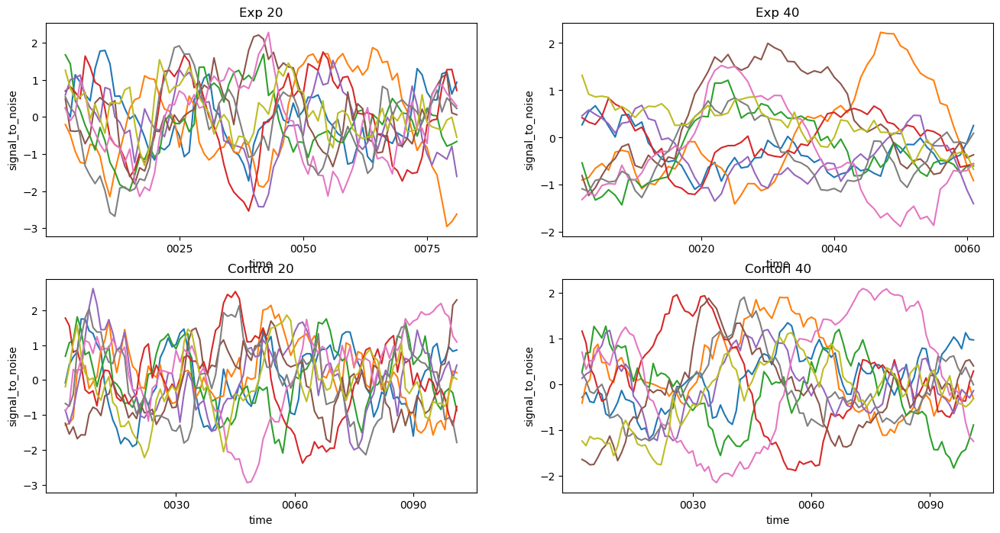

In [27]:
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(nrows=2, ncols=2, figsize=(16, 8));
test_plot_kwargs = dict(x='time', hue='model', add_legend=False)
exp_rolling_noise_True.signal_to_noise.sel(window=20).sel(lat=-38, lon=144, method='nearest').plot(ax=ax1, **test_plot_kwargs);
exp_rolling_noise_True.signal_to_noise.sel(window=40).sel(lat=-38, lon=144, method='nearest').plot(ax=ax2, **test_plot_kwargs);

control_rolling_noise_True.signal_to_noise.sel(window=20).sel(lat=-38, lon=144, method='nearest').plot(ax=ax3, **test_plot_kwargs);
control_rolling_noise_True.signal_to_noise.sel(window=40).sel(lat=-38, lon=144, method='nearest').plot(ax=ax4, **test_plot_kwargs);

ax1.set_title('Exp 20'); ax2.set_title('Exp 40'); ax3.set_title('Control 20'); ax4.set_title('Contorl 40');

# Local

## Calculations

In [28]:
def calculate_and_add_upper_and_lower_bound(ds:xr.Dataset, control_ds:xr.Dataset)->xr.Dataset:
    '''
    Takes the picontrol from a run and also the experiment in questions. The upper and lower bound 
    are calculated and added to the dataset
    '''
    control__lbound, control__ubound = sn.calculate_upper_and_lower_bounds(control_ds.signal_to_noise,
                                                                           logginglevel='INFO')
    
    ds_w_bounds = xe.add_lower_upper_to_dataset(ds.signal_to_noise,
                                                control__lbound, control__ubound)
    return ds_w_bounds

In [29]:
exp_local_sn_rolling_ds = calculate_and_add_upper_and_lower_bound(exp_rolling_noise_True,control_rolling_noise_True).persist()

- Calculating Upper and lower control bounds
- Map blocks used


In [30]:
exp_local_sn_rolling_ds

<xarray.Dataset>
Dimensions:          (lat: 96, lon: 192, time: 100, model: 9, window: 2)
Coordinates:
  * lat              (lat) float64 -88.57 -86.72 -84.86 ... 84.86 86.72 88.57
  * lon              (lon) float64 0.0 1.875 3.75 5.625 ... 354.4 356.2 358.1
  * time             (time) object 0001-12-31 00:00:00 ... 0100-12-31 00:00:00
  * model            (model) object 'ACCESS-ESM1-5' 'CESM2' ... 'UKESM1-0-LL'
  * window           (window) int64 20 40
    height           float64 ...
    variable         object ...
Data variables:
    signal_to_noise  (window, time, model, lat, lon) float64 dask.array<chunksize=(2, 98, 9, 96, 98), meta=np.ndarray>
    lower_bound      (window, model, lat, lon) float64 dask.array<chunksize=(2, 9, 96, 98), meta=np.ndarray>
    upper_bound      (window, model, lat, lon) float64 dask.array<chunksize=(2, 9, 96, 98), meta=np.ndarray>

In [32]:
unstable_sn_ds = exp_local_sn_rolling_ds.utils.above_or_below(
            'signal_to_noise', greater_than_var = 'upper_bound', less_than_var = 'lower_bound').signal_to_noise;
unstable_sn_ds

<xarray.DataArray 'signal_to_noise' (window: 2, time: 100, model: 9, lat: 96,
                                     lon: 192)>
dask.array<where, shape=(2, 100, 9, 96, 192), dtype=float64, chunksize=(2, 98, 9, 96, 98), chunktype=numpy.ndarray>
Coordinates:
  * lat       (lat) float64 -88.57 -86.72 -84.86 -83.0 ... 84.86 86.72 88.57
  * lon       (lon) float64 0.0 1.875 3.75 5.625 7.5 ... 352.5 354.4 356.2 358.1
  * time      (time) object 0001-12-31 00:00:00 ... 0100-12-31 00:00:00
  * model     (model) object 'ACCESS-ESM1-5' 'CESM2' ... 'UKESM1-0-LL'
  * window    (window) int64 20 40
    height    float64 2.0
    variable  <U3 'tas'

In [34]:
list(unstable_sn_ds.dims)

['window', 'time', 'model', 'lat', 'lon']

In [33]:
unstable_sn_ds

<xarray.DataArray 'signal_to_noise' (window: 2, time: 100, model: 9, lat: 96,
                                     lon: 192)>
dask.array<where, shape=(2, 100, 9, 96, 192), dtype=float64, chunksize=(2, 98, 9, 96, 98), chunktype=numpy.ndarray>
Coordinates:
  * lat       (lat) float64 -88.57 -86.72 -84.86 -83.0 ... 84.86 86.72 88.57
  * lon       (lon) float64 0.0 1.875 3.75 5.625 7.5 ... 352.5 354.4 356.2 358.1
  * time      (time) object 0001-12-31 00:00:00 ... 0100-12-31 00:00:00
  * model     (model) object 'ACCESS-ESM1-5' 'CESM2' ... 'UKESM1-0-LL'
  * window    (window) int64 20 40
    height    float64 2.0
    variable  <U3 'tas'

In [26]:
stable_unstable_args_da = sn.find_stable_and_unstable_years(unstable_sn_ds)
stable_unstable_args_da.name = 'time'
stable_unstable_args_da

<xarray.DataArray 'time' (window: 2, stability: 2, arg: 4, model: 9, lat: 96,
                          lon: 192)>
array([[[[[[ 0.,  0.,  0., ...,  0.,  0.,  0.],
           [ 5.,  5.,  0., ...,  5.,  5.,  5.],
           [ 5.,  5.,  0., ...,  7.,  7.,  5.],
           ...,
           [ 0.,  0.,  0., ...,  0.,  0.,  0.],
           [ 0.,  0.,  0., ...,  0.,  0.,  0.],
           [ 0.,  0.,  0., ...,  0.,  0.,  0.]],

          [[ 0.,  0.,  0., ...,  0.,  0.,  0.],
           [ 0.,  0.,  0., ...,  0.,  0.,  0.],
           [ 0.,  0.,  0., ...,  0.,  0.,  0.],
           ...,
           [ 5.,  5.,  5., ...,  5.,  5.,  5.],
           [ 5.,  5.,  5., ...,  5.,  5.,  5.],
           [12., 12., 12., ..., 12., 12., 12.]],

          [[ 2.,  2.,  2., ...,  2.,  2.,  2.],
           [ 0.,  2.,  2., ...,  2.,  2.,  2.],
           [ 0.,  0.,  0., ...,  0.,  0.,  0.],
           ...,
...
           ...,
           [nan, nan, nan, ..., nan, nan, nan],
           [nan, nan, nan, ..., nan, nan, nan],
           [nan, nan, nan, ..., nan, nan, nan]],

          [[nan, nan, nan, ..., nan, nan, nan],
           [nan, nan, nan, ..., nan, nan, nan],
           [nan, nan, nan, ..., nan, nan, nan],
           ...,
           [nan, nan, nan, ..., nan, nan, nan],
           [nan, nan, nan, ..., nan, nan, nan],
           [nan, nan, nan, ..., nan, nan, nan]],

          [[nan, nan, nan, ..., nan, nan, nan],
           [nan, nan, nan, ..., nan, nan, nan],
           [nan, nan, nan, ..., nan, nan, nan],
           ...,
           [nan, nan, nan, ..., nan, nan, nan],
           [nan, nan, nan, ..., nan, nan, nan],
           [nan, nan, nan, ..., nan, nan, nan]]]]]])
Coordinates:
  * lat        (lat) float64 -88.57 -86.72 -84.86 -83.0 ... 84.86 86.72 88.57
  * lon        (lon) float64 0.0 1.875 3.75 5.625 ... 352.5 354.4 356.2 358.1
  * model      (model) object 'ACCESS-ESM1-5' 'CESM2' ... 'UKESM1-0-LL'
  * window     (window) int64 20 40
    height     float64 2.0
    variable   <U3 'tas'
  * arg        (arg) int64 0 1 2 3
  * stability  (stability) <U8 'stable' 'unstable'

In [1]:
# Fraction of models stable at each time.
rolling_year_stable_local = sn.get_stable_year_ds(exp_local_sn_rolling_ds, max_effective_length=50).persist()
rolling_year_stable_local

NameError: name 'sn' is not defined

In [30]:
rollling_year_stable_local_average = xe.get_average_and_uncertainty_across_dim(
    rolling_year_stable_local, 'model', averaging_method='mean', uncertainty_method='max_min').squeeze()

rollling_year_stable_local_average

- averaging_method='mean', uncertainty_method='max_min'


<xarray.Dataset>
Dimensions:        (lat: 96, lon: 192, window: 2)
Coordinates:
  * lat            (lat) float64 -88.57 -86.72 -84.86 ... 84.86 86.72 88.57
  * lon            (lon) float64 0.0 1.875 3.75 5.625 ... 354.4 356.2 358.1
  * window         (window) int64 20 40
    height         float64 2.0
    variable       <U15 'signal_to_noise'
Data variables:
    average_value  (window, lat, lon) float64 dask.array<chunksize=(1, 96, 98), meta=np.ndarray>
    uncertainty    (window, lat, lon) float64 dask.array<chunksize=(1, 96, 98), meta=np.ndarray>

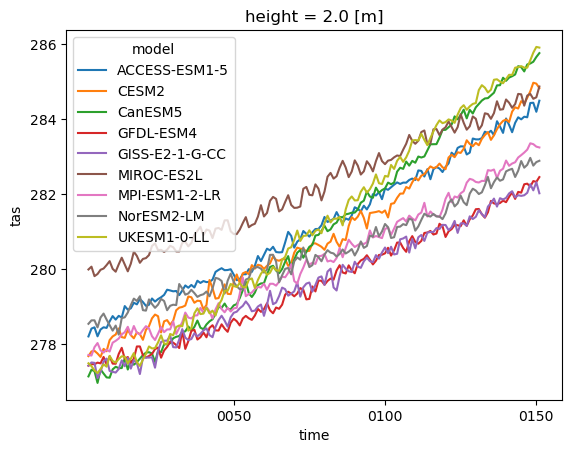

In [36]:
onepct_zec_da.mean(dim=['lat', 'lon']).plot(x='time', hue='model')

In [37]:
to_concat = []
for model in onepct_zec_da.model.values:
    single_model_ds = onepct_zec_da.sel(model=model)
    start_branch_year = int(zecmip_onepercent_branch_point['branch_year'][model])
    branch_mean_ds = single_model_ds.isel(time=slice(start_branch_year-10, start_branch_year+10)).mean(dim='time')
    to_concat.append(branch_mean_ds)
branch_point_mean_ds = xr.concat(to_concat, pd.Index(onepct_zec_da.model.values, name='model'))

In [38]:
experiment_zec_da_anom = experiment_zec_da - branch_point_mean_ds

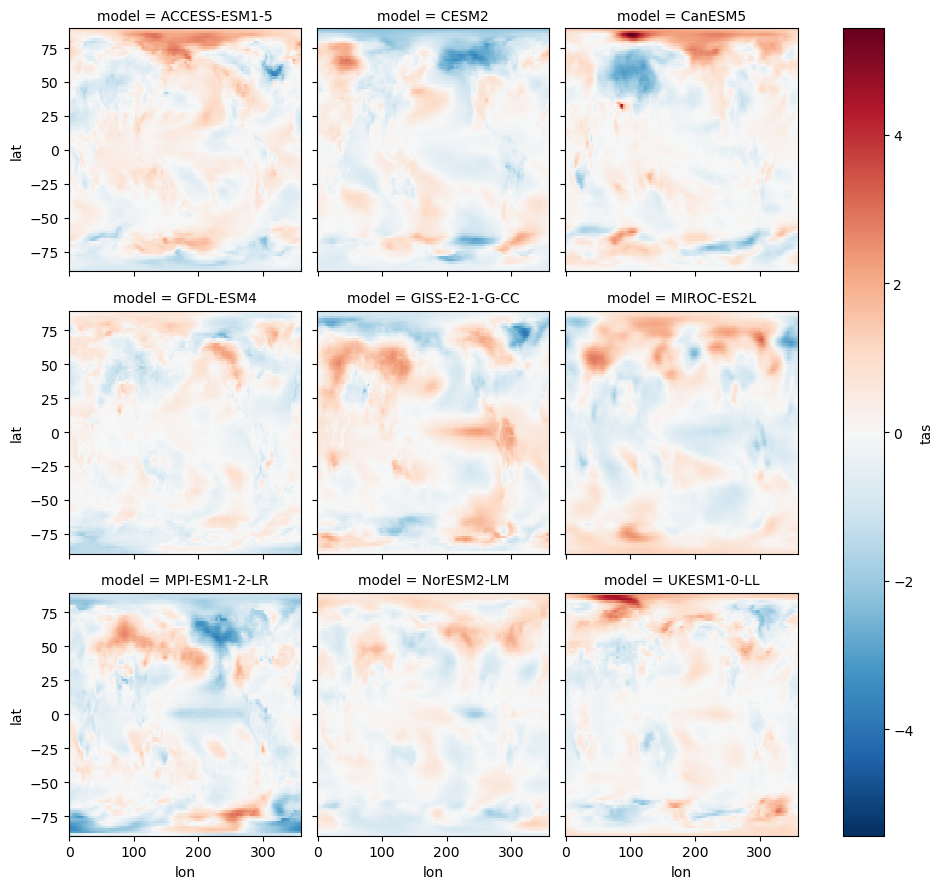

In [39]:
experiment_zec_da_anom.isel(time=0).plot(x='lon', y='lat', col='model', col_wrap=3)

In [40]:
experiment_zec_da_anom

<xarray.DataArray 'tas' (time: 100, model: 9, lat: 96, lon: 192)>
dask.array<subtract, shape=(100, 9, 96, 192), dtype=float32, chunksize=(100, 1, 96, 192), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -88.57 -86.72 -84.86 -83.0 ... 83.0 84.86 86.72 88.57
  * lon      (lon) float64 0.0 1.875 3.75 5.625 7.5 ... 352.5 354.4 356.2 358.1
  * time     (time) object 0001-12-31 00:00:00 ... 0100-12-31 00:00:00
  * model    (model) object 'ACCESS-ESM1-5' 'CESM2' ... 'UKESM1-0-LL'
    height   float64 2.0
    models   (model) object 'ACCESS-ESM1-5' 'CESM2' ... 'UKESM1-0-LL'

In [35]:
stable_anom_da = sn.get_stabel_average_anomaly_over_windows(
    experiment_zec_da_anom,rolling_year_stable_local.time).persist().chunk('auto'); stable_anom_da

<function get_stable_average_anomaly_lat_lon at 0x154e6b2e3ca0>


<xarray.DataArray 'temp' (window: 2, model: 9, lat: 96, lon: 192)>
dask.array<rechunk-merge, shape=(2, 9, 96, 192), dtype=float64, chunksize=(2, 9, 96, 192), chunktype=numpy.ndarray>
Coordinates:
  * lat       (lat) float64 -88.57 -86.72 -84.86 -83.0 ... 84.86 86.72 88.57
  * lon       (lon) float64 0.0 1.875 3.75 5.625 7.5 ... 352.5 354.4 356.2 358.1
  * model     (model) object 'ACCESS-ESM1-5' 'CESM2' ... 'UKESM1-0-LL'
  * window    (window) int64 20 40
    height    float64 2.0
    variable  <U15 'signal_to_noise'

In [36]:
gradient_da = stable_anom_da/(rolling_year_stable_local.time.squeeze()+1)
gradient_da = xr.where(gradient_da==np.inf, 0, gradient_da)

In [43]:
list(exp_local_sn_rolling_ds.signal_to_noise.dims)

['window', 'time', 'model', 'lat', 'lon']

In [37]:
#The goal here is to convert all of the unstable points into nan values. So when the count function is used, only the finite values get counted, 
# and we get the percent of points that are stable
stable_sn_da = sn.remove_all_unstable_points(exp_local_sn_rolling_ds.signal_to_noise.isel(time=slice(0,51)).squeeze(),                                           rolling_year_stable_local.time.squeeze())
stable_sn_da = stable_sn_da.isel(time=slice(0, 50))
stable_sn_da

20
40


<xarray.DataArray 'signal_to_noise' (window: 2, time: 50, model: 9, lat: 96,
                                     lon: 192)>
dask.array<getitem, shape=(2, 50, 9, 96, 192), dtype=float64, chunksize=(2, 50, 9, 96, 98), chunktype=numpy.ndarray>
Coordinates:
  * lat       (lat) float64 -88.57 -86.72 -84.86 -83.0 ... 84.86 86.72 88.57
  * lon       (lon) float64 0.0 1.875 3.75 5.625 7.5 ... 352.5 354.4 356.2 358.1
  * time      (time) object 0001-12-31 00:00:00 ... 0050-12-31 00:00:00
  * model     (model) object 'ACCESS-ESM1-5' 'CESM2' ... 'UKESM1-0-LL'
  * window    (window) int64 20 40
    height    float64 ...
    variable  object ...

In [38]:
stable_sn_da_advanced = sn.remove_unstable_years_advanced(
    exp_local_sn_rolling_ds.signal_to_noise.isel(time=slice(0,51)).transpose('time', 'window', 'model', 'lat', 'lon'),
    stable_unstable_args_da)

## Plotting

### Percent of Year Stable

In [39]:
def calculate_all_regional_dataset(ds, mask_ds) -> dict:
    total_points = mask_ds.lat.size * mask_ds.lon.size
    total_land = mask_ds.mask.sum().values
    total_ocean = total_points - total_land
    # print(f'{total_points=} {total_land=} {total_ocean=}')
    
    stor_obj = {}
    stor_obj['gl'] = ds.count(dim=['lat', 'lon'])*100/total_points
    stor_obj['nh'] = ds.sel(lat=slice(0, None)).count(dim=['lat', 'lon'])*100/(total_points/2)
    stor_obj['sh'] = ds.sel(lat=slice(None, 0)).count(dim=['lat', 'lon'])*100/(total_points/2)
    
    stor_obj['land'] = ds.where(mask_ds.mask).count(dim=['lat', 'lon'])*100/total_land
    stor_obj['ocean'] = ds.where(mask_ds.mask==0).count(dim=['lat', 'lon'])*100/total_ocean
    
    total_tropics = mask_ds.sel(lat=slice(-23, 23)).lat.size * mask_ds.lon.size
    stor_obj['tropics'] = ds.sel(lat=slice(-23, 23)).count(dim=['lat', 'lon'])*100/total_tropics
    
    total_mid_lats = mask_ds.sel(lat=slice(-66, 66)).lat.size * mask_ds.lon.size
    stor_obj['mid_latitudes'] = ds.sel(lat=slice(-66, 66)).count(dim=['lat', 'lon'])*100/total_mid_lats

    total_arctic = mask_ds.sel(lat=slice(66, None)).lat.size * mask_ds.lon.size
    stor_obj['arctic'] = ds.sel(lat=slice(66, None)).count(dim=['lat', 'lon'])*100/total_arctic
    
    total_antarctic = mask_ds.sel(lat=slice(None, -66)).lat.size * mask_ds.lon.size
    stor_obj['antarctic'] = ds.sel(lat=slice(None, -66)).count(dim=['lat', 'lon'])*100/total_antarctic
    
    stor_ds = xe.xr_dict_to_xr_dataset(stor_obj)
    return stor_ds

In [40]:
test_ds = stable_sn_da.sel(window=20).isel(model=0).compute(); test_ds

<xarray.DataArray 'signal_to_noise' (time: 50, lat: 96, lon: 192)>
array([[[-0.19171154, -0.18800502, -0.18579739, ..., -0.19864109,
         -0.19643438, -0.19367098],
        [        nan,         nan, -0.3573359 , ...,         nan,
                 nan,         nan],
        [        nan,         nan, -0.4188644 , ...,         nan,
                 nan,         nan],
        ...,
        [ 1.50080116,  1.55259794,  1.60072299, ...,  1.31934081,
          1.38695947,  1.44683228],
        [ 1.51391247,  1.53595445,  1.55860523, ...,  1.44664997,
          1.46889839,  1.49419783],
        [ 1.36237214,  1.36909883,  1.37566333, ...,  1.33381227,
          1.34201878,  1.3516939 ]],

       [[-0.37314817, -0.37223639, -0.37111728, ..., -0.37072273,
         -0.37181846, -0.3717961 ],
        [        nan,         nan, -0.56928823, ...,         nan,
                 nan,         nan],
        [        nan,         nan, -0.70304982, ...,         nan,
                 nan,         nan],
...
        [ 1.46336871,  1.46836616,  1.48378476, ...,  1.4372887 ,
          1.43859367,  1.44747665],
        [ 1.89512192,  1.89256948,  1.8846053 , ...,  1.90818367,
          1.90123594,  1.89863152],
        [ 1.9006702 ,  1.89275713,  1.88522132, ...,  1.92613767,
          1.91700108,  1.90897631]],

       [[ 0.54114596,  0.54200274,  0.5449304 , ...,  0.53458639,
          0.53689635,  0.53885753],
        [ 0.57032211,  0.57416537,  0.57603348, ...,  0.55229844,
          0.55837223,  0.56497634],
        [ 0.59645535,  0.59632504,  0.5906816 , ...,  0.58533825,
          0.59253278,  0.593029  ],
        ...,
        [ 0.35106036,  0.38130725,  0.41317726, ...,  0.18862524,
          0.24541053,  0.30002933],
        [ 0.85148788,  0.86322429,  0.87011947, ...,  0.78410376,
          0.8099321 ,  0.83641823],
        [ 1.08829825,  1.08504321,  1.08463075, ...,  1.08319503,
          1.0824946 ,  1.08511903]]])
Coordinates:
  * lat       (lat) float64 -88.57 -86.72 -84.86 -83.0 ... 84.86 86.72 88.57
  * lon       (lon) float64 0.0 1.875 3.75 5.625 7.5 ... 352.5 354.4 356.2 358.1
  * time      (time) object 0001-12-31 00:00:00 ... 0050-12-31 00:00:00
    model     <U13 'ACCESS-ESM1-5'
    window    int64 20
    height    float64 2.0
    variable  <U3 'tas'

In [2]:
test_binary_ds = xr.where(np.isfinite(test_ds), 1, 0)

NameError: name 'xr' is not defined

In [42]:
weights = np.cos(np.deg2rad(mask_ds.lat))
weights.name = 'weights'

In [43]:
test_sum = test_binary_ds.weighted(weights).sum(dim=['lat', 'lon'])

In [44]:
test_total_ds = xr.where(np.isfinite(test_ds), 1, 1).weighted(weights).sum(dim=['lat', 'lon'])

In [45]:
fraction_test = 100*test_sum/test_total_ds

In [1]:
fraction_test.plot(label='weigthed')
percent_stable_ds.sel(window=20, model='ACCESS-ESM1-5').gl.plot(label='not weighted')
plt.legend()

NameError: name 'fraction_test' is not defined

In [49]:
stable_sn_da = stable_sn_da.persist().chunk('auto')

In [47]:
percent_stable_ds = xr.concat([
    calculate_all_regional_dataset(stable_sn_da.sel(window=20), mask_ds),
    calculate_all_regional_dataset(stable_sn_da.sel(window=40), mask_ds)], dim='window')

In [48]:
percent_stable_ds = percent_stable_ds.persist()
percent_stable_ds

<xarray.Dataset>
Dimensions:        (time: 50, model: 9, window: 2)
Coordinates:
  * time           (time) object 0001-12-31 00:00:00 ... 0050-12-31 00:00:00
  * model          (model) object 'ACCESS-ESM1-5' 'CESM2' ... 'UKESM1-0-LL'
  * window         (window) int64 20 40
    height         float64 2.0
    variable       <U3 'tas'
Data variables:
    gl             (window, time, model) float64 dask.array<chunksize=(1, 50, 9), meta=np.ndarray>
    nh             (window, time, model) float64 dask.array<chunksize=(1, 50, 9), meta=np.ndarray>
    sh             (window, time, model) float64 dask.array<chunksize=(1, 50, 9), meta=np.ndarray>
    land           (window, time, model) float64 dask.array<chunksize=(1, 50, 9), meta=np.ndarray>
    ocean          (window, time, model) float64 dask.array<chunksize=(1, 50, 9), meta=np.ndarray>
    tropics        (window, time, model) float64 dask.array<chunksize=(1, 50, 9), meta=np.ndarray>
    mid_latitudes  (window, time, model) float64 dask.array<chunksize=(1, 50, 9), meta=np.ndarray>
    arctic         (window, time, model) float64 dask.array<chunksize=(1, 50, 9), meta=np.ndarray>
    antarctic      (window, time, model) float64 dask.array<chunksize=(1, 50, 9), meta=np.ndarray>

In [ ]:
# stor_obj = {20:  calculate_all_regional_dataset(stable_sn_da.sel(window=20), mask_ds),
#             40: calculate_all_regional_dataset(stable_sn_da.sel(window=40), mask_ds)}
# print(stor_obj.keys(), stor_obj[20].keys(), sep='\n')

In [51]:
NAMING_MAP = dict(gl='Global', nh='Northern Hemisphere', sh='Southern Hemisphere', tropics='Tropics', land='Land', ocean='Ocean',
                 mid_latitudes='Mid Latitudes', arctic='Arctic', antarctic='Antarctic')

In [52]:
line_plot_kwargs = dict(xlabel='Time after net-zero emissions (years)', labelpad=70, ncol=1, exp_type='zecmip',
                        xlim=(0, 1), font_scale=1.8)
left_kwargs = dict(add_legend=False, ylabel='Percent of\nPoints Stable (%)')

In [53]:
reload(constants)
reload(sn_plotting)
reload(plotting_functions)

<module 'plotting_functions' from '/home/563/ab2313/Documents/PhD/modules/plotting_functions.py'>

In [54]:
# num=9
# tcmap = plt.cm.get_cmap('coolwarm', num)
# tcmap(np.arange(num-9, num))

/g/data/w40/ab2313/images/PhD/top_level/01_percent_points_stable_all_models_20.png


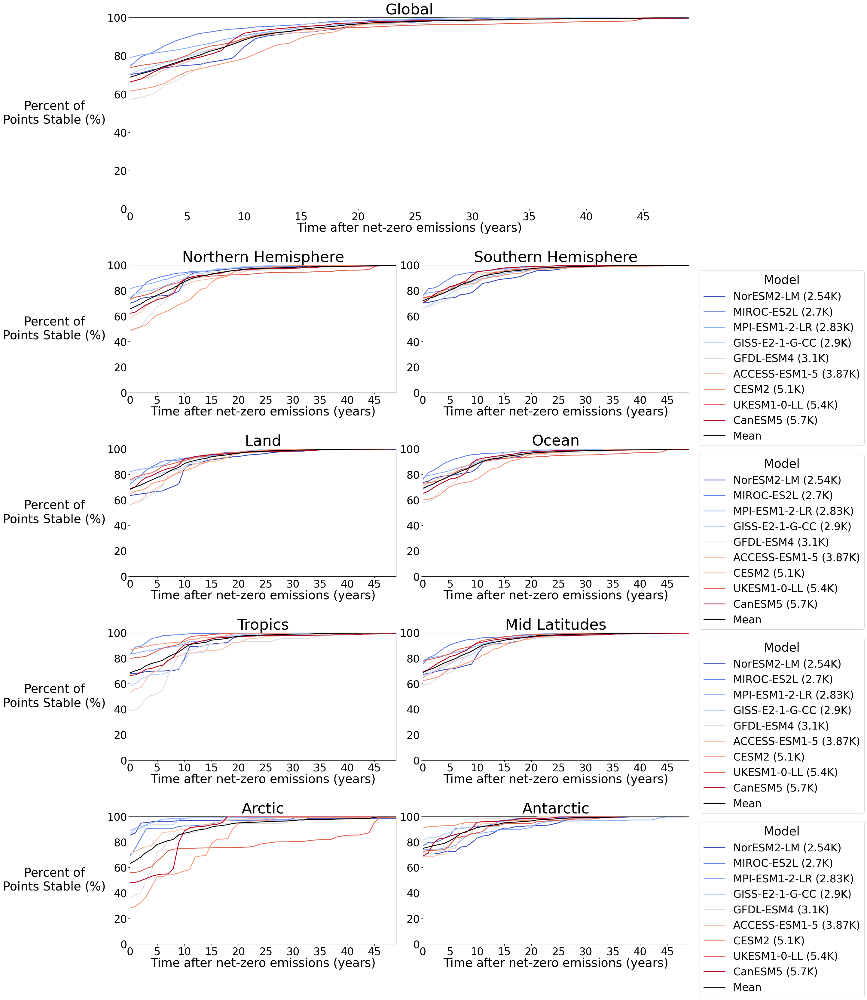

In [55]:
window = 20
plt.style.use('default')
nplots = len(percent_stable_ds)+1
fig = plt.figure(figsize=(12*2, 4*nplots))
gs = gridspec.GridSpec(int(np.ceil(nplots/2)), 2, height_ratios=[1.5] + [1]*int(np.ceil((nplots-2)/2)), wspace=0.1, hspace=0.4)
ax0 = fig.add_subplot(gs[0, :]); axes = [fig.add_subplot(gs[i+2]) for i in range(nplots-2)]
axes.insert(0, ax0)

for num, reg in enumerate(percent_stable_ds):
    kwargs_to_use = left_kwargs if ((num%2) or (num==0)) else {}
    sn_plotting.plot_all_coord_lines(percent_stable_ds[reg].sel(window=window), fig=fig, ax=axes[num],
                                     title=NAMING_MAP[reg], **kwargs_to_use, **line_plot_kwargs);
    axes[num].set_xlim([stable_sn_da.time.values[0], stable_sn_da.time.values[-1]]); axes[num].set_ylim(0, 100)

save_name = os.path.join(constants.IMAGE_SAVE_DIR_TOP_LEVEL, f'{notebook_number}_percent_points_stable_all_models_{window}.png')
print(save_name); fig.savefig(save_name, dpi=300, bbox_inches='tight');

In [56]:
style_dict = {'gl':{'color':'black', 'linewidth':5, 'zorder':100},
              'land':{'color':'brown', 'linestyle':'--'}, 'ocean':{'color':'blue', 'linestyle':'--'},
              'nh':{'color':'m', 'linestyle':(0, (1,1))}, 'sh':{'color':'orange', 'linestyle':(0, (1,1))},
              'tropics':{'color':'darkgreen'}, 'mid_latitudes':{'color':'red'},
              'arctic':{'color':'lightblue'}, 'antarctic':{'color':'darkblue'}}

/g/data/w40/ab2313/images/PhD/top_level/01_percent_points_stable.png


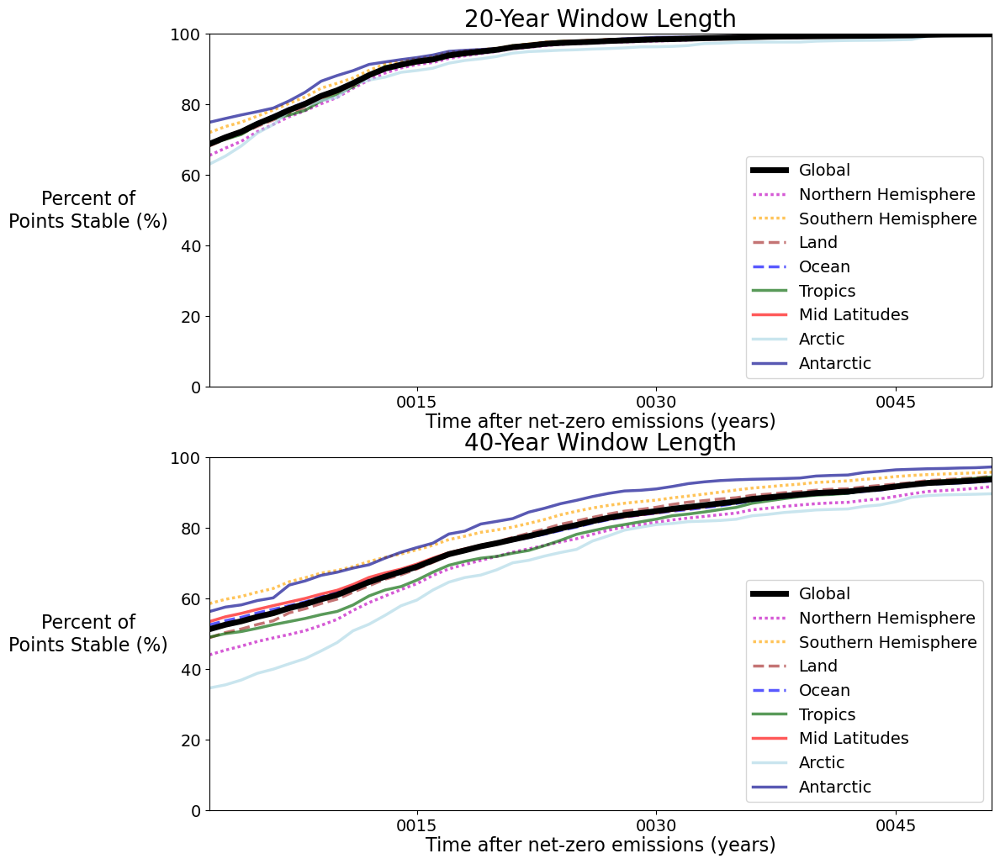

In [57]:
plt.style.use('default')
fig, axes = plt.subplots(nrows=2, figsize=(12, 6*2))

base_style_dict = {'linewidth':2.5, 'alpha':0.65}
for num, reg in enumerate(percent_stable_ds):
    style = style_dict[reg]
    if reg != 'gl': style = dict(**base_style_dict, **style)
    percent_stable_ds[reg].sel(window=20).mean(dim='model').plot(ax=axes[0], label=NAMING_MAP[reg], **style)
    percent_stable_ds[reg].sel(window=40).mean(dim='model').plot(ax=axes[1], label=NAMING_MAP[reg], **style)

for ax, window in zip(axes, percent_stable_ds.window.values):
    ax.legend(fontsize=constants.PlotConfig.legend_text_size);
    ax.set_title(None); ax.set_ylim([0, 100])
    ax.set_xlim([stable_sn_da.time.values[0], stable_sn_da.time.values[-1]]);
    plotting_functions.format_axis(ax, ylabel='Percent of\nPoints Stable (%)', xlabel='Time after net-zero emissions (years)',
                                   labelpad=70, title=f'{window}-Year Window Length');

save_name = os.path.join(constants.IMAGE_SAVE_DIR_TOP_LEVEL, f'{notebook_number}_percent_points_stable.png'); print(save_name)
fig.savefig(save_name, dpi=300, bbox_inches='tight');

### 1D Lat Lon Selection

In [58]:
def get_location_title(location: LocationsLatLon) -> str:
    lat,lon = location.value

    str_lat = str(abs(round(lat, 1)))
    str_lon = str(abs(round(lon, 1)))
    str_lat = str_lon + 'N' if lat > 0 else str_lon + 'S'
    str_lon = str_lon +'E' if lon > 0 else str_lon + 'W'
    location_name = location.name.replace('_', ' ').title()
    location_title = f'{location_name}'  + r' ({}, {})'.format(str_lat, str_lon)
    return location_title

In [59]:
def plot_single_point_all_models(ds, location: LocationsLatLon, length =50, start=0,
                                 fig=None, ax=None, legend_on: bool=True, bbox_to_anchor = [-0.03, 1],
                                ylabel=None, xlabel=None, ylim=None, linestyle=':'):
    lat,lon = location.value
    plt.style.use('seaborn-darkgrid')

    models = [model for model in list(constants.ZECMIP_MODEL_PARAMS) if model in ds.model.values]

    if fig is None: fig  = plt.figure(figsize=(10,8)); ax = fig.add_subplot(111)
        
    for model in models:
        da = (ds.sel(model=model)
              .isel(time=slice(start, length))
              .sel(lat=lat, lon=lon, method='nearest')
             )
        color = constants.ZECMIP_MODEL_PARAMS[model]['color']
        da.plot(ax=ax, label=model, linestyle=linestyle, color=color)
    if legend_on:
        leg = ax.legend()
        ax.legend(ncol=1, fontsize=15, bbox_to_anchor=bbox_to_anchor, frameon=True)
        leg.get_title().set_fontsize('15')
    ax.set_xlim(ds.time.values[start], ds.time.values[length])
    
    ax.set_title(get_location_title(location))
    ax.tick_params(axis='x', labelsize=12)
    ax.tick_params(axis='y', labelsize=12)
    
    if ylabel: ax.set_ylabel(ylabel,fontsize = 16, rotation = 0, labelpad = 55)
    if xlabel: ax.set_xlabel(xlabel, fontsize=16)
    if ylim: ax.set_ylim(ylim)
        
    return fig, ax

In [60]:
def local_point_plot(values_ds, stable_values_ds, window, location, stable_points, fig=None, ax=None,
                    legend_on=True, ylabel=None, xlabel=None, ylim=None):

    fig, ax = plot_single_point_all_models(
        stable_values_ds.sel(window=window), location, fig=fig, ax=ax, linestyle='solid',
        legend_on=legend_on)

    plot_single_point_all_models(values_ds, location, fig=fig, ax=ax, legend_on=False,
      ylabel=f'{ylabel_name}\n{constants.VARIABLE_INFO[variable]["units"]}',
                                xlabel='Time after net-zero emissions (years)')

    for model, point in stable_points[window].items():
        color = color = constants.MODEL_PARAMS[model.lower()]['color']
        ax.scatter(point[0], point[1], zorder=100, color=color, edgecolor='k', s=25)
        
    if ylabel: ax.set_ylabel(ylabel,fontsize = 16, rotation = 0, labelpad = 55)
    if xlabel: ax.set_xlabel(xlabel, fontsize=16)
    if ylim:ax.set_ylim(ylim)
    ax.tick_params(axis='x', labelsize=12)
    ax.tick_params(axis='y', labelsize=12)
        
    return fig, ax

In [61]:
def plot_lat_lon_value_and_sn(value_ds, sn_ds, stable_ds, location:classes.locationsLatLon2,
                              step=1, vmax=None, vmin=None, levels=None, vmax2=None, 
                             ylabel=None,max_stabilisation_year:int=999):
    '''
    Plots the temperature, signal-to-noise, s-n bounds, and year of stabilisation 
    all on different axes subplots.
    '''
    lat, lon= location.value
    models = value_ds.model.values
    value_ds_lat_lon = value_ds.sel(lat=lat, lon=lon, method='nearest')
    stable_ds_lat_lon = stable_ds.sel(lat=lat, lon=lon, method='nearest')
    sn_ds_lat_lon = sn_ds.sel(lat=lat, lon=lon, method='nearest')
    
    fig = plt.figure(figsize=(10, 24))
    ncols = 1
    nrows = int(np.ceil(len(models)/ncols))
    gs = gridspec.GridSpec(nrows, ncols, hspace=.4)
    
    if levels is None:
        if vmax is None: vmax = np.ceil(np.abs(value_ds_lat_lon.values).max())
        if vmin is None: vmin = -vmax
        levels = np.arange(vmin, vmax+step, step)

    for model_num,model in enumerate(models):
        ax = fig.add_subplot(gs[model_num])
        ax2 = ax.twinx()
        
        signal_colors = ['red', 'orange']
        for num, window in enumerate(stable_ds_lat_lon.window.values):
 
            sn_ds_lat_lon.sel(window=window).signal_to_noise.sel(model=model).plot(
                ax=ax2, color=signal_colors[num], label=f'SN Ratio ({window}-year window)')
            stable_year = int(stable_ds_lat_lon.sel(model=model).sel(window=window).time.values[0])
            if stable_year < max_stabilisation_year: # If above this, then does not stabilise within run lenght
                # temp_at_stable_year = (value_ds_lat_lon.isel(time=stable_year).sel(model=model).values)
                sn_at_stable_year = sn_ds_lat_lon.sel(window=window, model=model).isel(time=stable_year).signal_to_noise.values
                ax2.scatter(experiment_zec_da_anom.time.values[stable_year], sn_at_stable_year,#stable_year,#temp_at_stable_year,
                           color=signal_colors[num], label=f'Stabilisation Year\n({window}-year window)')

            lb = sn_ds_lat_lon.sel(window=window).lower_bound.sel(model=model).values
            ub = sn_ds_lat_lon.sel(window=window).upper_bound.sel(model=model).values
    
        
            bounds_kwargs = dict(color=signal_colors[num], linestyle='--', alpha=.35)
            time = sn_ds_lat_lon.time.values
            ax2.plot(time, [lb] *len(time), label=f'{window}-year Window Bounds', **bounds_kwargs)
            ax2.plot(time, [ub] *len(time), **bounds_kwargs)
            
            if vmax2: ax2.set_ylim(-vmax2, vmax2)
            ax.set_ylim(vmin, vmax)
            ax.set_yticks(levels)
            ax2_levels = np.linspace(ax2.get_yticks()[0], ax2.get_yticks()[-1], len(levels))
            ax2.set_yticks(ax2_levels)
            
            ax2.set_ylabel("Signal-to-Noise Ratio")
            
            if model_num == 0: ax2.legend(ncol=3, bbox_to_anchor=(1, 1.65))#bbox_to_anchor=(1.35+.03, 1.1))
            # ax.legend(ncol=1,  bbox_to_anchor=(1.27+.03, .56))
        value_ds_lat_lon.sel(model=model).plot(ax=ax, color='blue')

        ax.set_title(model)
        ax2.set_title(model)
        ax.set_ylabel("Tempeature Anomaly (K)"); ax.set_xlabel('Time after net-zero emissions (years)')
    return fig

In [62]:
reload(classes)

<module 'classes' from '/home/563/ab2313/Documents/PhD/modules/classes.py'>

In [63]:
dir(classes.locationsLatLon2)

['ANTARCTIC',
 'ARCTIC',
 'EASTERN_PACIFIC',
 'NORTHERN_EUROPE',
 'SOLOMON_ISLANDS',
 '__class__',
 '__doc__',
 '__members__',
 '__module__']

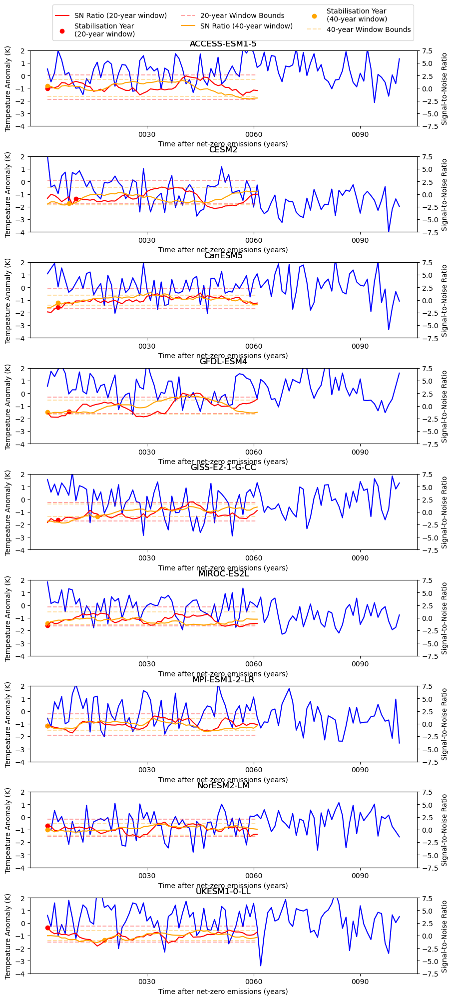

In [64]:
location = classes.locationsLatLon2.NORTHERN_EUROPE
fig = plot_lat_lon_value_and_sn(experiment_zec_da_anom, exp_local_sn_rolling_ds.isel(time=slice(None, 60)),
                          rolling_year_stable_local,location, step=1, vmax=2, vmin=-4, vmax2=6, max_stabilisation_year = 40)

save_name = os.path.join(constants.IMAGE_SAVE_DIR_TOP_LEVEL,
                         f'{notebook_number}_zec_local_time_series_{location.name}.png')
# print(save_name); fig.savefig(save_name, dpi=300, bbox_inches='tight')

### Geo2D

In [65]:
rolling_year_stable_local.isel(window=0)

<xarray.Dataset>
Dimensions:   (lat: 96, lon: 192, model: 9, variable: 1)
Coordinates:
  * lat       (lat) float64 -88.57 -86.72 -84.86 -83.0 ... 84.86 86.72 88.57
  * lon       (lon) float64 0.0 1.875 3.75 5.625 7.5 ... 352.5 354.4 356.2 358.1
  * model     (model) object 'ACCESS-ESM1-5' 'CESM2' ... 'UKESM1-0-LL'
    window    int64 20
    height    float64 2.0
  * variable  (variable) object 'signal_to_noise'
Data variables:
    time      (variable, model, lat, lon) float64 dask.array<chunksize=(1, 9, 96, 98), meta=np.ndarray>

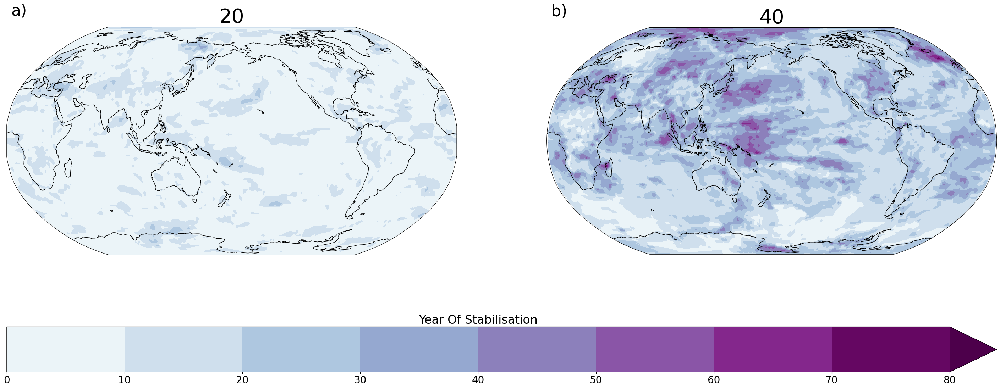

In [68]:
vm =40; step=5; levels_mean_stab= np.arange(0, vm+step, step)
fig = plt.figure(figsize=(18*2, 14))
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    rollling_year_stable_local_average['average_value'].squeeze(), dim='window', fig=fig,
    levels=levels_mean_stab, ncols=2, cmap='BuPu', extend='max',
    cbar_title="Year Of Stabilisation", font_scale=2)

In [78]:
td = rollling_year_stable_local_average['average_value'].squeeze().sel(window=40)

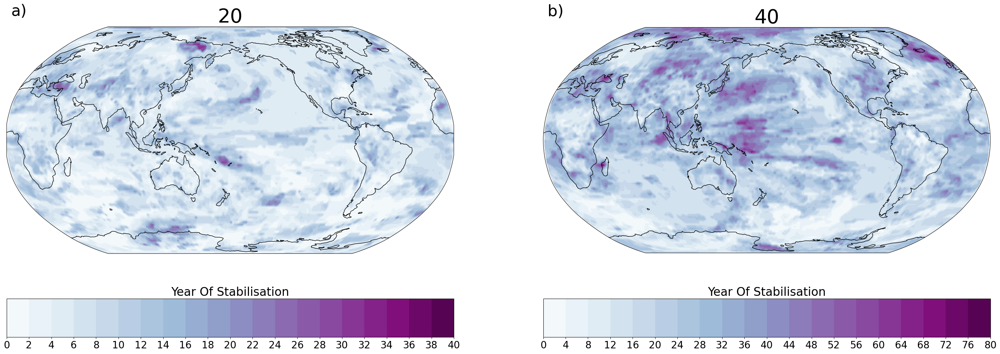

In [80]:
vm =40; step=2; levels_mean_stab2 = np.arange(0, vm+step, step)
vm =20; step=1; levels_mean_stab1 = np.arange(0, vm+step, step)

fig = plt.figure(figsize=(18*2, 12))
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    rollling_year_stable_local_average['average_value'].squeeze(), dim='window', fig=fig,
    levels=[levels_mean_stab1, levels_mean_stab2], ncols=2, extend='neither', cmap='BuPu',
    cbar_title="Year Of Stabilisation", font_scale=2)

/g/data/w40/ab2313/images/PhD/top_level/01_zec_stabilisation_uncertainty.png


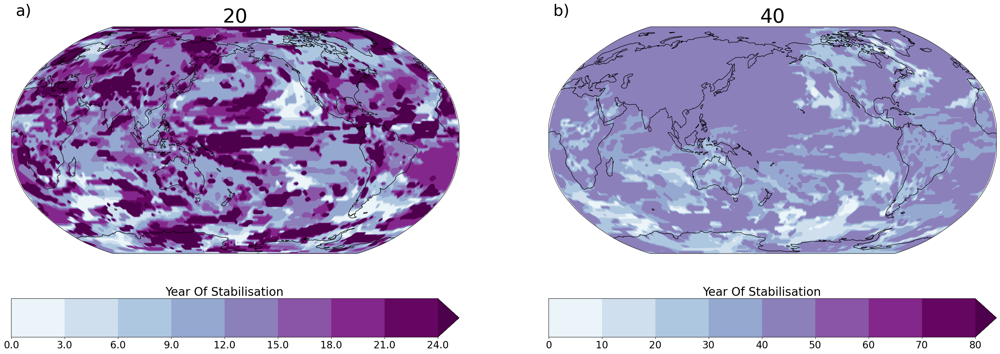

In [81]:
vm =40; step=5; levels_mean_stab2 = np.arange(0, vm+step, step)
vm =12; step=1.5; levels_mean_stab1 = np.arange(0, vm+step, step)

fig = plt.figure(figsize=(18*2, 12))
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    rollling_year_stable_local_average['uncertainty'].squeeze(), dim='window', fig=fig,
    levels=[levels_mean_stab1, levels_mean_stab2], ncols=2, cmap='BuPu', extend='max',
    cbar_title="Year Of Stabilisation", font_scale=2)


save_name = os.path.join(constants.IMAGE_SAVE_DIR_TOP_LEVEL,
                         f'{notebook_number}_zec_stabilisation_uncertainty.png')
print(save_name)
fig.savefig(save_name, dpi=300, bbox_inches='tight')

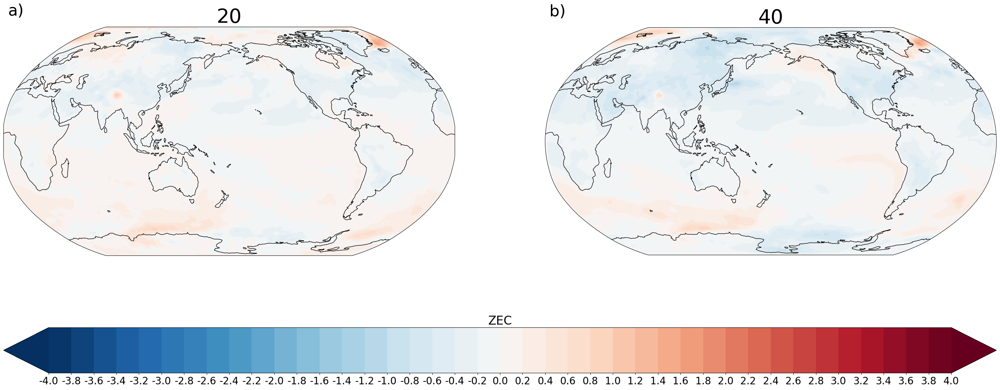

In [82]:
vm = 2; step=.1; levels_mean_anom = np.arange(-vm, vm+step, step) # based upon 99th percentile of abs.
fig = plt.figure(figsize=(18*2, 14))
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    stable_anom_da.mean(dim='model'), dim='window', fig=fig, levels=levels_mean_anom, ncols=2,
    cbar_title="ZEC", font_scale=2)

In [83]:
bounds_reformated = (exp_local_sn_rolling_ds.mean(dim='model')
     .squeeze()
     .drop('variable')[['upper_bound', 'lower_bound']]
     .to_array()
     .rename({'variable': 'bound'})).sel(bound=['lower_bound', 'upper_bound'])

In [84]:
universaL_kwargs = dict(ncols=2, font_scale=2, add_label=False)

/g/data/w40/ab2313/images/PhD/top_level/01_zec_mean_sn_bound.png


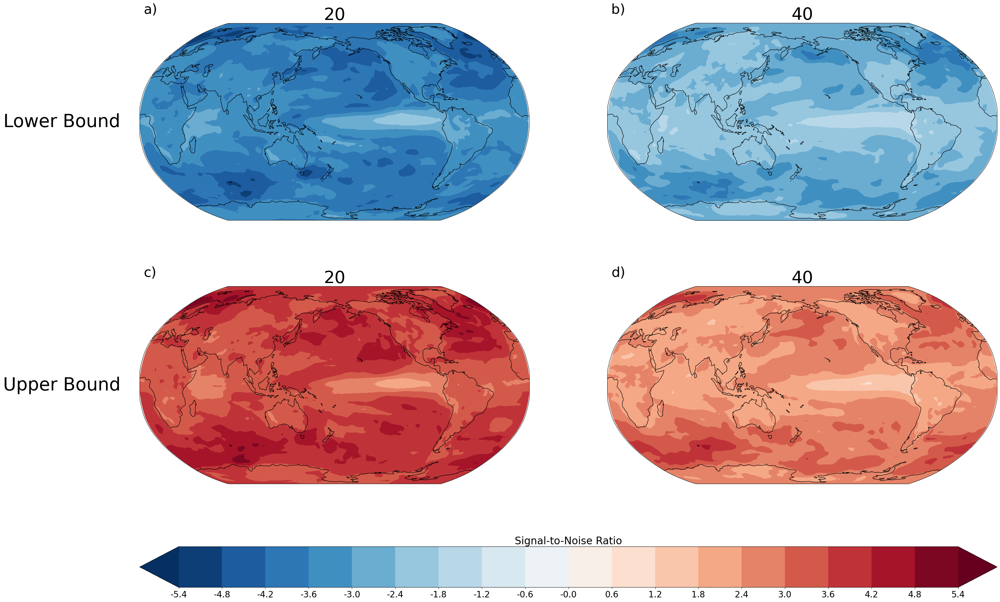

In [91]:
# All mean value plots
ntypes = 2

fig = plt.figure(figsize=(18*2, 12*ntypes))
gs = gridspec.GridSpec(3, 2, height_ratios = [1, 1, 0.2], hspace=0.4)
projection = ccrs.Robinson(central_longitude=int(np.mean(rollling_year_stable_local_average.lon.values)))

all_axes = []

bound = 2.7; step=0.3; signal_to_noise_levels = np.arange(-bound, bound+step, step)

fig, gs, axes = sn_plotting.map_plot_all_for_coords_3(
    bounds_reformated.sel(bound='lower_bound'), dim='window',
    levels=signal_to_noise_levels, cmap='RdBu_r',
    cbar_title="Signal-to-Noise Ratio",
    fig=fig, gs=gs,
    axes = [fig.add_subplot(gs[0, 0], projection=projection),
            fig.add_subplot(gs[0, 1], projection=projection)],
#     cax = [plt.subplot(gs[1, :])],
    add_colorbar=False,
    **universaL_kwargs)

all_axes.extend(axes)

fig, gs, axes = sn_plotting.map_plot_all_for_coords_3(
    bounds_reformated.sel(bound='upper_bound'), dim='window',
    levels=signal_to_noise_levels, cmap='RdBu_r',
    cbar_title="Signal-to-Noise Ratio",
    fig=fig, gs=gs,
    axes = [fig.add_subplot(gs[1, 0], projection=projection),
            fig.add_subplot(gs[1, 1], projection=projection)],
    cax = [plt.subplot(gs[2, :])],
    **universaL_kwargs)
all_axes.extend(axes)


y_axis_kwargs = dict(xy=(-0.2, 0.5), ha='center', va='center',
                     xycoords='axes fraction', rotation=0, size=21*universaL_kwargs['font_scale'])
row_labels = ['Lower Bound', 'Upper Bound']
for num, ax in enumerate(all_axes):
    plotting_functions.add_figure_label(ax, f'{chr(97+num)})', font_scale=universaL_kwargs['font_scale'])
    if num%2 == 0: ax.annotate(row_labels[int(num/2)], **y_axis_kwargs)
        
save_name = os.path.join(constants.IMAGE_SAVE_DIR_TOP_LEVEL,
                         f'{notebook_number}_zec_mean_sn_bound.png')
print(save_name)
fig.savefig(save_name, dpi=300, bbox_inches='tight')

- full garbage collection released 39.00 MiB from 85718 reference cycles (threshold: 9.54 MiB)


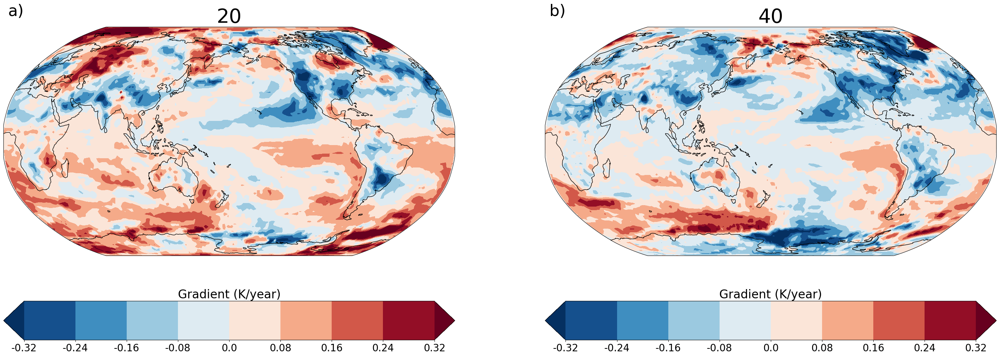

In [92]:
vm =.16; step=.04; levels_mean_stab2 = np.arange(-vm, vm+step, step)
vm =.16; step=.04; levels_mean_stab1 = np.arange(-vm, vm+step, step)

fig = plt.figure(figsize=(18*2, 12))
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    gradient_da.mean(dim='model').squeeze(), dim='window', fig=fig,
    levels=[levels_mean_stab1, levels_mean_stab2], ncols=2, cmap='RdBu_r', extend='both',
    cbar_title="Gradient (K/year)", font_scale=2)

/g/data/w40/ab2313/images/PhD/top_level/01_zec_stabilisation_statistics.png


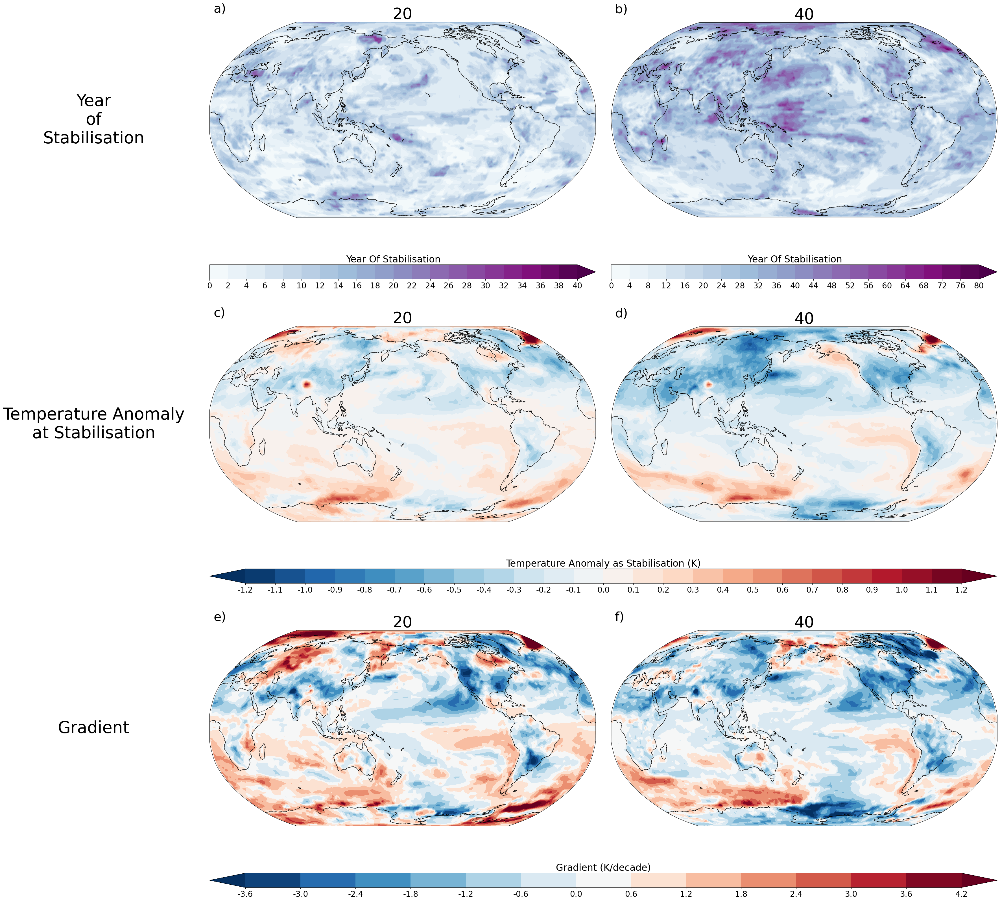

In [93]:
# All mean value plots
ntypes = 3

fig = plt.figure(figsize=(18*2, 14*ntypes))
gs = gridspec.GridSpec(ntypes*2, 2, height_ratios = [1, 0.05]*ntypes, hspace=0, wspace=0.04)
projection = ccrs.Robinson(central_longitude=int(np.mean(rollling_year_stable_local_average.lon.values)))

universaL_kwargs = dict(ncols=2, font_scale=2, add_label=False)
all_axes = []


### Year of Stabilisation
vm =40; step=2; levels_mean_stab2 = np.arange(0, vm+step, step)
vm =20; step=1; levels_mean_stab1 = np.arange(0, vm+step, step)
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    rollling_year_stable_local_average['average_value'].squeeze(), dim='window',
    levels=[levels_mean_stab1, levels_mean_stab2], cmap='BuPu', extend='max',
    cbar_title="Year Of Stabilisation",
    fig=fig, gs=gs,
    axes = [fig.add_subplot(gs[0, 0], projection=projection),
            fig.add_subplot(gs[0, 1], projection=projection)],
    cax = [plt.subplot(gs[1, 0]), plt.subplot(gs[1, 1])],
    **universaL_kwargs)
all_axes.extend(axes)


### Temperature Anomaly at Stabilisation
vm = .6; step=.05; levels_mean_anom = np.arange(-vm, vm+step, step) # based upon 99th percentile of abs.
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    stable_anom_da.mean(dim='model'), dim='window', levels=levels_mean_anom, cbar_title="Temperature Anomaly as Stabilisation (K)",
    fig=fig, gs=gs,
    axes = [fig.add_subplot(gs[2, 0], projection=projection),
            fig.add_subplot(gs[2, 1], projection=projection)],
    cax = [plt.subplot(gs[3, :])],
    **universaL_kwargs)
all_axes.extend(axes)


### Gradient
vm =.18; step=.03; levels_mean_grad = np.arange(-vm, vm+step, step)
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    gradient_da.mean(dim='model').squeeze()*10, dim='window',
    levels=levels_mean_grad*10, cmap='RdBu_r', extend='both', cbar_title="Gradient (K/decade)",
    fig=fig, gs=gs,
    axes = [fig.add_subplot(gs[4, 0], projection=projection),
            fig.add_subplot(gs[4, 1], projection=projection)],
    cax = [plt.subplot(gs[5, :])]#, plt.subplot(gs[5, 1])]
    , **universaL_kwargs)
all_axes.extend(axes)

y_axis_kwargs = dict(xy=(-0.3, 0.5), ha='center', va='center',
                     xycoords='axes fraction', rotation=0, size=21*universaL_kwargs['font_scale'])
row_labels = ['Year\nof\nStabilisation', 'Temperature Anomaly\nat Stabilisation', 'Gradient']
for num, ax in enumerate(all_axes):
    plotting_functions.add_figure_label(ax, f'{chr(97+num)})', font_scale=universaL_kwargs['font_scale'])
    if num%2 == 0: ax.annotate(row_labels[int(num/2)], **y_axis_kwargs)
        
save_name = os.path.join(constants.IMAGE_SAVE_DIR_TOP_LEVEL,
                         f'{notebook_number}_zec_stabilisation_statistics.png')
print(save_name)
fig.savefig(save_name, dpi=300, bbox_inches='tight')

In [94]:
reload(sn_plotting)

<module 'sn_plotting' from '/home/563/ab2313/Documents/PhD/modules/sn_plotting.py'>

- full garbage collection released 168.11 MiB from 29742 reference cycles (threshold: 9.54 MiB)
/g/data/w40/ab2313/images/PhD/top_level/01_zec_stabilisation_year_20_window.png


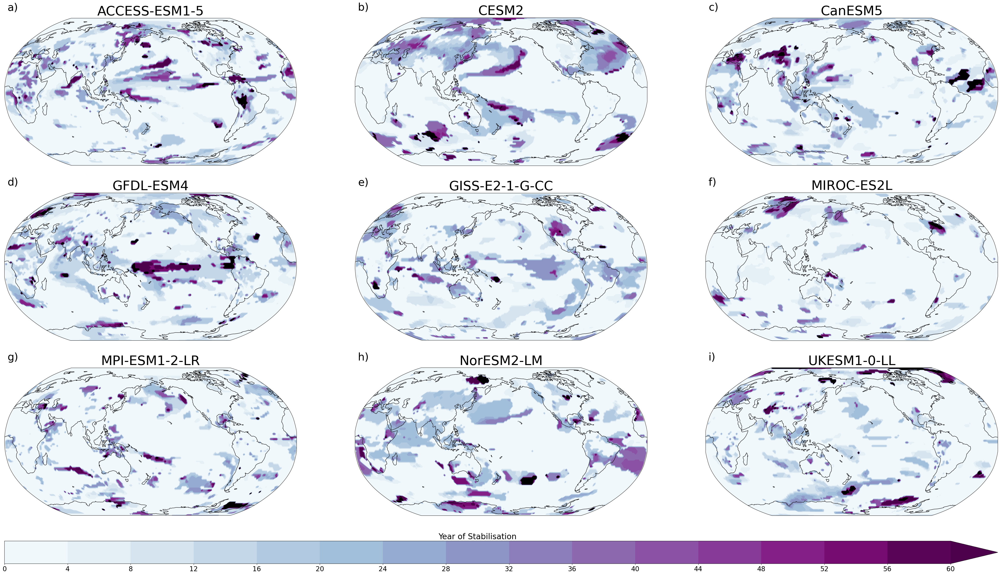

In [95]:
vm = 30; step=2; levels_stable = np.arange(0, vm+step, step) 
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    rolling_year_stable_local.sel(window=20).time.squeeze(),
    dim='model', levels=levels_stable, cmap='BuPu', extend='max',
    max_stabilisation_year=40, stabilisation_method = 'blackout', 
    cbar_title="Year of Stabilisation", font_scale=2)

save_name = os.path.join(constants.IMAGE_SAVE_DIR_TOP_LEVEL,
                         f'{notebook_number}_zec_stabilisation_year_20_window.png')
print(save_name)
fig.savefig(save_name, dpi=300, bbox_inches='tight')

In [96]:
reload(sn_plotting)

<module 'sn_plotting' from '/home/563/ab2313/Documents/PhD/modules/sn_plotting.py'>

/g/data/w40/ab2313/images/PhD/top_level/01_zec_stabilisation_year_40_window.png


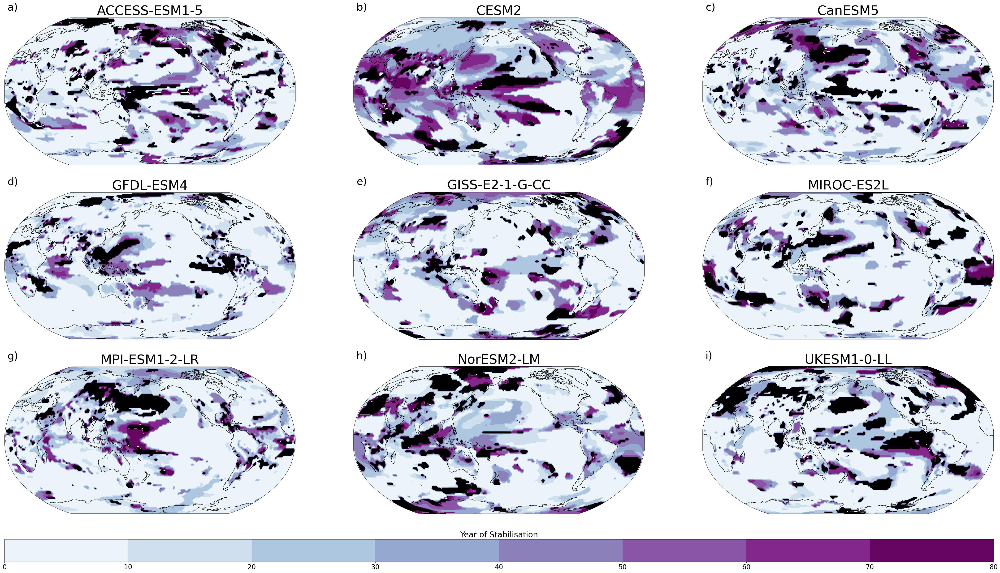

In [97]:
vm = 40; step=5; levels_stable = np.arange(0, vm+step, step) 
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    rolling_year_stable_local.sel(window=40).time.squeeze(),
    dim='model', levels=levels_stable, cmap='BuPu', extend='neither',
    max_stabilisation_year=40, stabilisation_method = 'blackout',
    cbar_title="Year of Stabilisation", font_scale=2)


save_name = os.path.join(constants.IMAGE_SAVE_DIR_TOP_LEVEL,
                         f'{notebook_number}_zec_stabilisation_year_40_window.png')
print(save_name)
# fig.savefig(save_name, dpi=300, bbox_inches='tight')

/g/data/w40/ab2313/images/PhD/top_level/01_zec_at_stabilisation_20_window.png


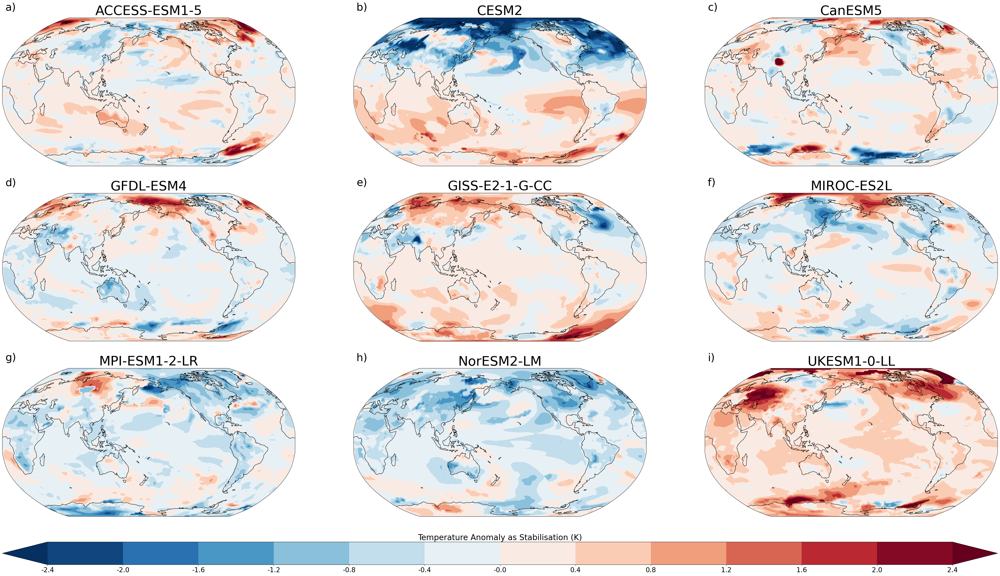

In [98]:
vm = 1.2; step=.2; levels_anom = np.arange(-vm, vm+step, step) # based upon 99th percentile of abs.
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(stable_anom_da.sel(window=20), dim='model',
                                                      levels=levels_anom, cbar_title="Temperature Anomaly as Stabilisation (K)", font_scale=2)


save_name = os.path.join(constants.IMAGE_SAVE_DIR_TOP_LEVEL,
                         f'{notebook_number}_zec_at_stabilisation_20_window.png')
print(save_name)
# fig.savefig(save_name, dpi=300, bbox_inches='tight')

In [99]:
def stippling(da, ax):
    X, Y = np.meshgrid(da.lon, da.lat)
    ax.scatter(X,Y, da.values, c='k', transform=ccrs.PlateCarree())

- full garbage collection released 40.34 MiB from 83973 reference cycles (threshold: 9.54 MiB)
/g/data/w40/ab2313/images/PhD/top_level/01_zec_at_stabilisation_40_window.png


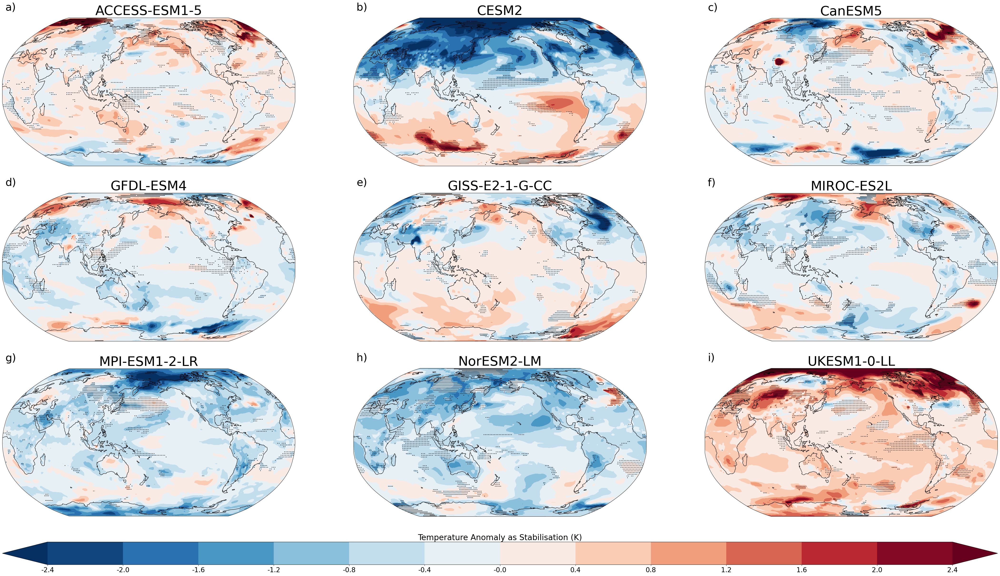

In [100]:
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(stable_anom_da.sel(window=40), dim='model', levels=levels_anom, 
                         cbar_title="Temperature Anomaly as Stabilisation (K)", font_scale=2)

for ax in axes:
    model = ax.get_title()
    da = rolling_year_stable_local.sel(window=40, model=model).time.squeeze()
    da = xr.where(da>40, 1,0)
    stippling(da, ax)

save_name = os.path.join(constants.IMAGE_SAVE_DIR_TOP_LEVEL,
                         f'{notebook_number}_zec_at_stabilisation_40_window.png')
print(save_name)
fig.savefig(save_name, dpi=300, bbox_inches='tight')

/g/data/w40/ab2313/images/PhD/top_level/01_zec_gradient_20_window.png


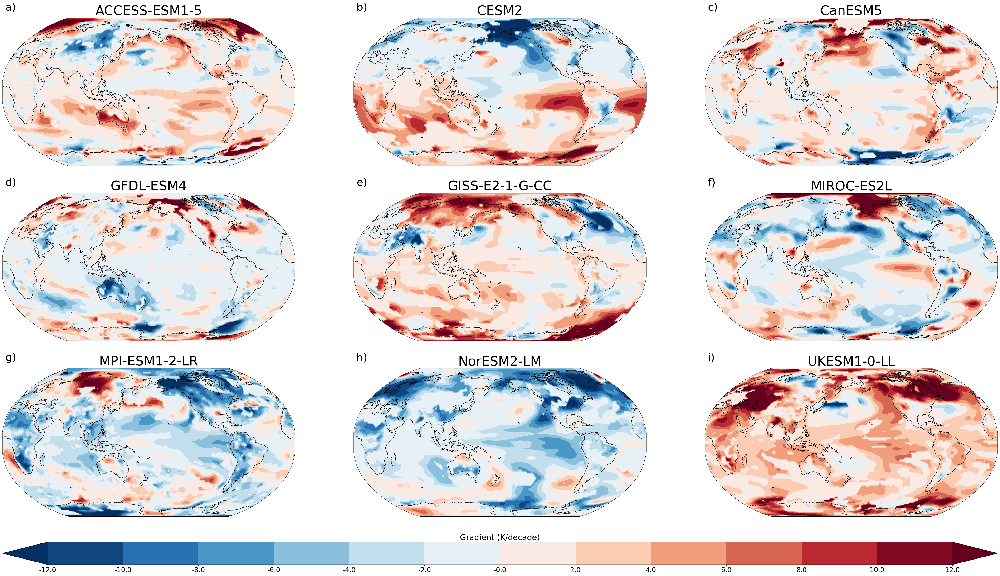

In [101]:
vm = .6; step=.1; levels_grad = np.arange(-vm, vm+step, step) # based upon 99th percentile of abs.
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(gradient_da.sel(window=20)*10, dim='model',
                                                      levels=levels_grad*10, cbar_title="Gradient (K/decade)",
                                                      font_scale=2)

save_name = os.path.join(constants.IMAGE_SAVE_DIR_TOP_LEVEL,
                         f'{notebook_number}_zec_gradient_20_window.png')
print(save_name)
fig.savefig(save_name, dpi=300, bbox_inches='tight')

/g/data/w40/ab2313/images/PhD/top_level/01_zec_gradient_40_window.png


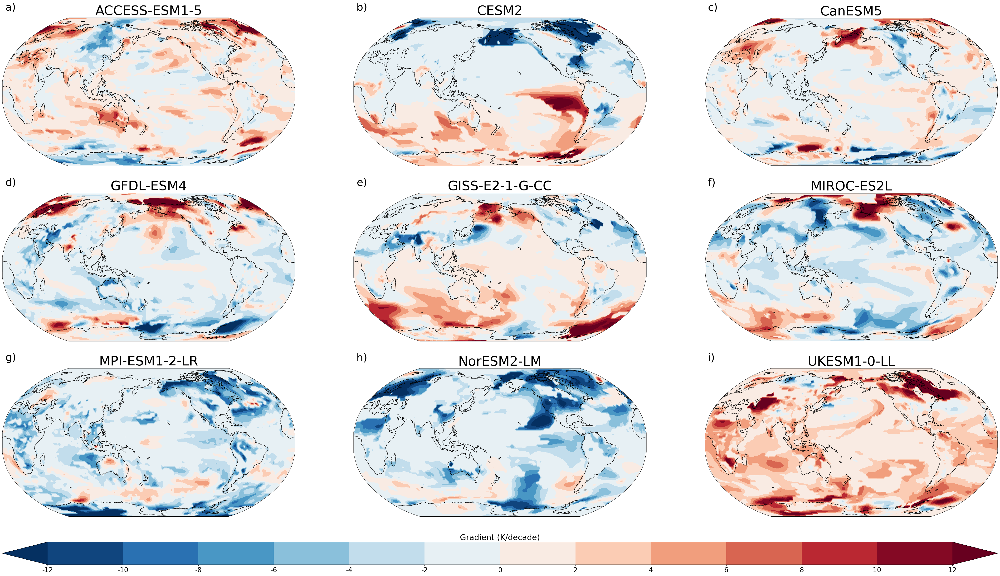

In [102]:
vm = 6; step=1; levels_grad = np.arange(-vm, vm+step, step) # based upon 99th percentile of abs.
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(gradient_da.sel(window=40)*10, dim='model',
                                                      levels=levels_grad, cbar_title="Gradient (K/decade)",
                                                      font_scale=2)

save_name = os.path.join(constants.IMAGE_SAVE_DIR_TOP_LEVEL,
                         f'{notebook_number}_zec_gradient_40_window.png')
print(save_name)
fig.savefig(save_name, dpi=300, bbox_inches='tight')

# Drift Comparison

In [ ]:
#### TODO: Do not import as *. Add drift_functino. as prefix to all necissary functions
from drift_functions import *

In [ ]:
# P-values
pi_pval_da = calculate_pvals(picontrol_zec_da.isel(time=slice(0, 100)))
exp_pval_da = calculate_pvals(experiment_zec_da)

In [ ]:
exp_pval_da.isel(model=0).plot()

In [ ]:
# Just the p-values that are less tha 0.05
pi_sig_da = xr.where(pi_pval_da < 0.05, 1, np.nan)#.astype(int)
exp_sig_da = xr.where(exp_pval_da < 0.05, 1, np.nan)#.astype(int)

In [ ]:
fig = plt.figure(); ax = fig.add_subplot(111, projection=ccrs.Robinson())
sn_plotting.plot_stippled_data(exp_pval_da.isel(model=0), ax)

In [ ]:
# Calculating the gradient over the 100 year run length
gradient_exp_full_da = calculate_trend(experiment_zec_da);
gradient_pi_full_da = calculate_trend(picontrol_zec_da.isel(time=slice(0, 100)))

In [ ]:
# Multiplying gradient by 50 to get K per 50 years
gradient_exp_full_da = (gradient_exp_full_da*50).persist()
gradient_pi_full_da = (gradient_pi_full_da*50).persist()

In [ ]:
# Difference in the gradients
gradient_full_diff = gradient_exp_full_da-gradient_pi_full_da

In [ ]:
reload(sn_plotting)

In [ ]:
# All mean value plots
models = gradient_full_diff.model.values
nrows = len(models); ncols = 3
fig = plt.figure(figsize=(6*ncols, 8*ncols))
gs = gridspec.GridSpec(nrows+1, ncols, height_ratios = [1]*nrows +[0.2], hspace=.2, wspace=0)
projection = ccrs.Robinson(central_longitude=int(np.mean(gradient_full_diff.lon.values)))

drift_plot_levels = np.arange(-1.4, 1.4, .2)
drift_plot_kwargs = dict(levels=drift_plot_levels, extend='both', cmap='RdBu_r', add_label=False, font_scale=0.7)
vm =40; step=5; levels_mean_stab2 = np.arange(0, vm+step, step)
all_axes = []

### A1

fig, gs, axes1 = sn_plotting.map_plot_all_for_coords_3(
    gradient_exp_full_da, dim='model',
    fig=fig, gs=gs, add_colorbar=False, stipling_da=exp_sig_da,
    axes = [fig.add_subplot(gs[i, 0], projection=projection) for i in range(len(models))],
    **drift_plot_kwargs)

for num, (ax, model) in enumerate(zip(axes1, models)):
    # ax.set_ylabel(model, labelpad=500)
    # sn_plotting.plot_stippled_data(pi_sig_da.sel(model=model), ax) # TODO: This is not working in the `map_plot_all_for_coords_3` function
    if num == 0: ax.set_title('A1 Experiment', fontsize=constants.PlotConfig.title_size*drift_plot_kwargs['font_scale'])
    else: ax.set_title('')
    
y_axis_kwargs = dict(xy=(-.25, 0.5), ha='center', va='center', xycoords='axes fraction', rotation=0,
                     size=constants.PlotConfig.title_size*drift_plot_kwargs['font_scale'])
for model, ax in zip(models, axes1): ax.annotate(model, **y_axis_kwargs)
all_axes.extend(axes1)


#### Pi-control

fig, gs, axes2 = sn_plotting.map_plot_all_for_coords_3(
    gradient_pi_full_da, dim='model',
    fig=fig, gs=gs, add_colorbar=False,stipling_da=pi_sig_da, 
    axes = [fig.add_subplot(gs[i, 1], projection=projection) for i in range(len(models))],
    **drift_plot_kwargs)
for ax in axes2: ax.set_title('')
axes2[0].set_title('Pre-Industrial Control', size=constants.PlotConfig.title_size*drift_plot_kwargs['font_scale'])

all_axes.extend(axes2)

### Diff

fig, gs, axes3 = sn_plotting.map_plot_all_for_coords_3(
    gradient_full_diff, dim='model',
     cbar_title="Gradient (K /(50 year))", fig=fig, gs=gs,
    axes = [fig.add_subplot(gs[i, 2], projection=projection) for i in range(len(models))],
    cax = plt.subplot(gs[nrows, :]), 
    **drift_plot_kwargs)
for ax in axes3: ax.set_title('')
axes3[0].set_title('Difference', size=constants.PlotConfig.title_size*drift_plot_kwargs['font_scale'])
all_axes.extend(axes3)

for num, ax in enumerate(all_axes): plotting_functions.add_figure_label(ax, f'{chr(97+num)})', font_scale=0.7)

save_name = os.path.join(constants.IMAGE_SAVE_DIR_TOP_LEVEL,
                         f'{notebook_number}_zec_mdoel_drift.png')
print(save_name)
fig.savefig(save_name, dpi=300, bbox_inches='tight')

In [ ]:
client.close()